# Wstęp

Przyjrzyjmy się na koniec dwóm ciekawym zagadnieniom: dzieleniu sekretu i steganrografii. Steganografia jako taka polega na ukrywaniu informacji. Niekoniecznie natomiast wiąże się z jej szyfrowaniem (choć te dwie techniki oczywiście można połączyć). Dzielenie sekretu to nie jest szyfrowanie, haszowanie czy ukrywanie - to jeszcze inna bajka i od niej zaczniemy.

## Dzielenie sekretu

Wyjść trzeba od tego co to jest sekret. Jak już na pewno dało się zauważyć na naszych zajęciach - może to być wszystko. Liczba, tekst, obraz... bo wszystko to jest ciągiem binarnym i może być interpretowane jak nam wygodnie (np. jako liczba czy tablica bajtów). 

Na czym więc podlega to całe dzielenie? Otóż chodzi o to, aby całość sekretu podzielić na $X$ kawałków. Te kawałki zwą się udziałami i mogą mieć różne formy - to zależy od wybranego algorytmu (o tym za chwilę). Do przywrócenia sekretu konieczne jest posiadanie przynajmniej $N$ udziałów, gdzie $1 < N \leq X$. W zależności od wybranej wersji algorytmu nie musi być konieczne posiadanie wszystkich $X$ udziałów - choć oczywiście i tak bywa. 

Podsumowując:
1. pojedynczy udział niesie dokładnie 0% informacji o sekrecie,
2. $N - 1$ udziałów pozwala przywrócić 0% sekretu,
3. $N$ udziałów lub więcej pozwala przywrócić dokładnie 100% sekretu.

Dzisiaj poznasz trzy algorytmy pozwalające spełnić te założenia.

### Protokół Blakley'a

**Protokół Blakleya** jest algorytmem dzielenia sekretu spełniającym założenia opisane we wstępie. Sama idea jest taka, że w n-wymiarowej przestrzeni możemy zdefiniować n podprzestrzeni o kowymiarze równym 1, które przecinają się w jednym punkcie. Kowymiar jest różnicą pomiędzy wymiarem przestrzeni w której definiujemy podprzestrzenie, a wymiarem podprzestrzeni. Przykłady:

1. weźmy dwie proste narysowane na płaszczyźnie. Płaszczyzna  jest dwuwymiarowa, a proste są jednowymiarowe. Kowymiar więc się zgadza (2 – 1 = 1). Dwie takie proste zawsze dadzą jeden punkt przecięcia pod warunkiem, że nie będą równoległe. Dla dociekliwych: w przestrzeni euklidesowej, ale innych nie będziemy tutaj rozważać.

2. jako drugi przykład rozpatrzmy trzy płaszczyzny (2D) w przestrzeni trójwymiarowej (3D). Kowymiar również się zgadza (3 – 2 = 1). Prawidłowo dobrane (tutaj ograniczeń jest więcej, nie wystarczy fakt, że nie są równoległe), będą dawały jeden punkt w którym wszystkie się przecinają.


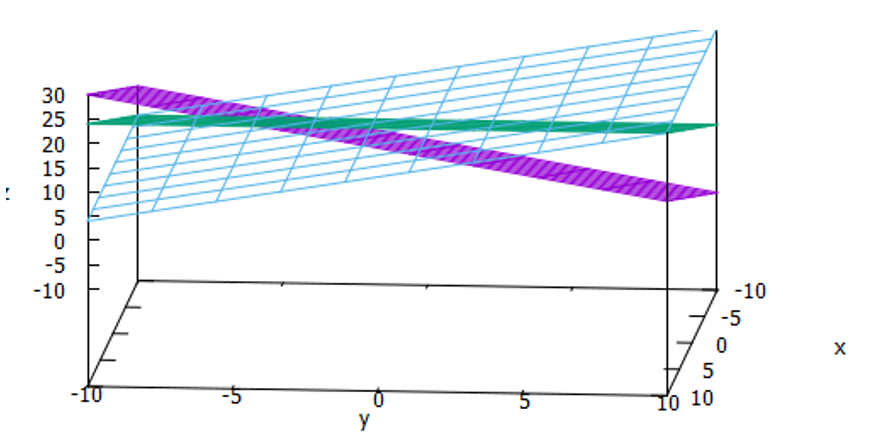


Im więcej wymiarów, tym trudniej to sobie wyobrazić. W każdym razie, sekretem jest (zawsze, bez względu na wymiar podprzestrzeni) jedna dowolna współrzędna punktu przecięcia. Załóżmy np. współrzędną $z$.

**Płaszczyzna** w klasycznej formie zadana jest wzorem:

\begin{equation}
  \pi: Ax + By + Cz + D = 0.
\end{equation}
Gdzie A, B, C i D to wartości stałe. Inną formą przedstawienia płaszczyzny jest:
\begin{equation}
  \pi: A(x - x_0) + B(y - y_0) + C(z - z_0) = 0.
\end{equation}
Gdzie $n = [A, B, C]$ jest wektorem normalnym płaszczyzny $\pi$ (czyli prostopadłym do niej), natomiast $P_0(x_0, y_0, z_0) \in \pi$. Generalnie do jednoznacznego  zdefiniowania płaszczyzny potrzeba trzech punktów. Jednak jest pewne założenie które muszą one spełniać. Zastanów się jakie, może to być potrzebne. 

Załóżmy więc, że mamy 3 punkty: $P_1(x_1, y_1, z_1)$, $P_2(x_2, y_2, z_2)$, $P_3(x_3, y_3, z_3)$ i wszystkie należą do $\pi$. Do wyznaczenia wzoru musimy utwórzyć dwa dowolne wektory z tych punktów, np.: $\overrightarrow{P_1P_2}$, $\overrightarrow{P_1P_3}$. Następnie należy obliczyć iloczyn wektorowy, który da nam parametry $A, B, C$: $\overrightarrow{P_1P_2} \times \overrightarrow{P_1P_3} = [A, B, C]$. Posiadając $A, B, C$, możemy wyznaczyć równanie płaszczyzny wstawiając dowolny z 3 puntków do równania $\pi$.

**Zadanie**

Otrzymałeś 3 pliki png w folderze *Blakley*. Każdy obraz reprezentuje punkty jednej płaszczyzny, innej niż są zakodowane w pozostałych obrazach. Przez punkt na płaszczyźnie rozumiemy piksel obrazu, który posiada współrzędne (x, y) (obie są z zakresu od 0 do 99), oraz wartość z (od 0 do 255) zakodowaną na kanale R, G albo B. Współrzędna x określa położenie piksela względem szerokości obrazu (czyli kolumny), a y względem jego wysokości (czyli wiersze).  
Wyznacz trzecią współrzędną punktu przecięcia płaszczyzn (czyli z) która jest sekretem - jeżeli punkt przecięcia istnieje. 

Zaproponuj równania (bez tworzenia obrazów) trzech płaszczyzn, które się przecinają w jednym punkcie, a współrzędna $z$ tego przecięcia to rok Twojego urodzenia. Unikaj równań typu: z = 0 itp. Niech to będą ,,normalne'' płaszczyzny.


**Uwaga** w tym zadaniu nie musisz nic kodować (choć oczywiście możesz), ale możesz też przedstawić swoje obliczenia/wyniki poniżej.

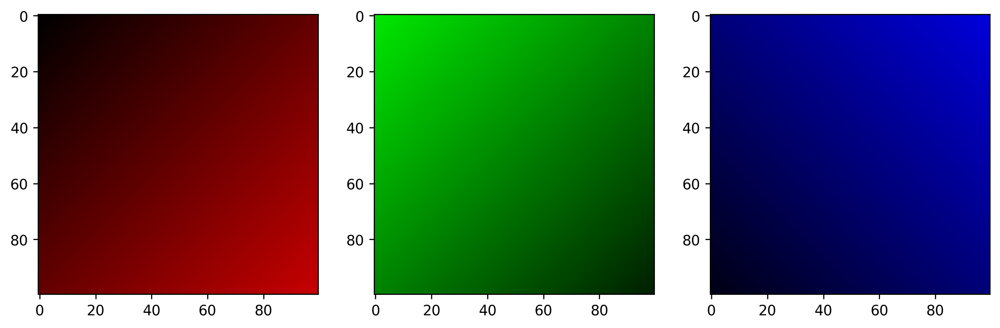

In [1]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image


def load_image(file) :
    img = Image.open(file)
    img.load()
    return np.asarray(img, dtype=np.int32)


img_1 = load_image('Blakley/Plane1.png')
img_2 = load_image('Blakley/Plane2.png')
img_3 = load_image('Blakley/Plane3.png')

fig, axs = plt.subplots(1, 3, figsize=(12, 4), dpi=250)
axs[0].imshow(img_1)
axs[1].imshow(img_2)
axs[2].imshow(img_3)
plt.show()

In [2]:
def find_plane(img, channel):
    n, m, _ = img.shape
    
    # P1 = [0, 0, z1]
    # P2 = [n, 0, z2]
    # P3 = [0, m, z3]
    
    v1 = img[n - 1, 0, channel] - img[0, 0, channel]
    v2 = img[0, m - 1, channel] - img[0, 0, channel]
    v = np.cross([n - 1, 0, v1], [0, m - 1, v2])
    
    A, B, C = v
    D = A * 0 + B * 0 + C * img[0, 0, channel]  # P0 = [0, 0, z1]
    
    return A, B, C, D
    

planes = np.stack([find_plane(img_1, 0), find_plane(img_2, 1) , find_plane(img_3, 2)], axis=0)
X, y = planes[:, :3], planes[:, 3]

_, _, z = np.linalg.solve(X, y)
print(z)

115.0


### Protokół Shamira

Jest o wiele wydajniejszy i prostszy niż Protokół Blakley'a. No bo wyobraź sobie, do jakich figur byśmy doszli, gdyby potrzeba było utworzyć np. 10 udziałów, a nie tylko 3. Protokół Shamira operuje jedynie na wielomianach i prostych twierdzeniach.

Bazą jest wielomian stopnia $t$, a sekretem jego wyraz wolny ($a_0$):

\begin{equation}
  y = a_0 + a_1x + a_2x^2 + ... + a_tx^t.
\end{equation}
Częściami sekretu (które są wysyłane do partycypujących w procesie) jest przynajmniej $t + 1$ punktów wielomianu $(x_i, y_i)$. Mając $t + 1$ punktów:

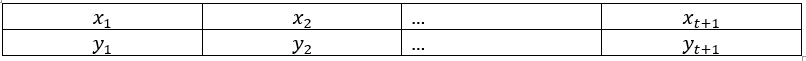


wyraz wolny możemy bardzo łatawo obliczyć metodą interporalcji Lagrange'a w punkcie $x = 0$:

\begin{equation}
  L(x) = \sum_{i = 1}^{t + 1}y_il_i(x),
\end{equation}

gdzie:

\begin{equation}
  l_i(x) = \prod_{0 < j \leq t + 1, j \neq i}\frac{x - x_j}{x_i - x_j}.
\end{equation}

I to w zasadzie tyle. Jak widać nie zawsze potrzebujemy bardzo skomplikowanych równań i algebry w kryptografii. Dobrze to też było widać przy szyfrze Vernama.


**Zadanie**

Otrzymujesz następujący zestaw punktów:
<table>
  <tr>
    <td>x</td>
    <td>y</td>
  </tr>
  <tr>
    <td>5027</td>
    <td>3699449103382758261754106949207544471454331</td>
  </tr>
  <tr>
    <td>8333</td>
    <td>349576516734879619790566193445084198972308523</td>
  </tr>
  <tr>
    <td>1455</td>
    <td>52758551617965323692566002328583494155</td>
  </tr>
  <tr>
    <td>4905</td>
    <td>2965581782568084168683433606320308652250155</td>
  </tr>
  <tr>
    <td>8966</td>
    <td>675640223694406898403633373039391357127095280</td>
  </tr>
  <tr>
    <td>3169</td>
    <td>58169797939549320184626851454156476789483</td>
  </tr>
  <tr>
    <td>3047</td>
    <td>40855813084060894710898142472133428124971</td>
  </tr>
  <tr>
    <td>6344</td>
    <td>30033876172374373466567262566305934018650758</td>
  </tr>
  <tr>
    <td>7907</td>
    <td>217990565378476135178090255955458242555277691</td>
  </tr>
  <tr>
    <td>4559</td>
    <td>1535290198484552235280022288343332387627403</td>
  </tr>
</table>

Napisz program, przywracający sekret z tych punktów z wykorzystaniem interpolacji Lagrange'a. Dla ułatwienia dodam, że sekretem jest liczba 2030. Wskazówka: możesz się zetknąć z problemem dokładności dzielenia, ale na szczęście w Pythonie jest coś takiego jak klasa *Decimal*.

Utwórz własny zestaw punktów, a sekretem niech będzie Twój rok urodzenia. Wykorzystaj napisany program do przywrócenia i tego sekretu (sprawdź czy się zgadza).

In [3]:
from decimal import *

getcontext().prec = 200


def shamir(xs, ys):
    secret = Decimal(0)
    
    for i in range(len(xs)):
        n, d = Decimal(1), Decimal(1)
        
        for j in range(len(xs)):
            if i != j:
                n *= -xs[j]
                d *= xs[i] - xs[j]
                
        secret += ys[i] * (n / d)

    return int(secret)
    

xs = [5027, 8333, 1455, 4905, 8966, 3169, 3047, 6344 ,7907, 4559]
      
ys_2030 = [
    3699449103382758261754106949207544471454331,
    349576516734879619790566193445084198972308523,
    52758551617965323692566002328583494155,
    2965581782568084168683433606320308652250155,
    675640223694406898403633373039391357127095280,
    58169797939549320184626851454156476789483,
    40855813084060894710898142472133428124971,
    30033876172374373466567262566305934018650758,
    217990565378476135178090255955458242555277691,
    1535290198484552235280022288343332387627403
]

ys_2000 = [
    336226330033079751719121513423274827,
    31773207028308999601435533092061416649,
    4793338823543595036508992826415,
    269527482810143825387765766821606765,
    61409687898355091228562566003235933660,
    5286357671300964126531838804958005,
    3712863488321974537401491583409047,
    2729723636651660251404549440543795280,
    19813195383184308852182025879239600907,
    139533630713341156931480764134514575
]

print(shamir(xs, ys_2030))
print(shamir(xs, ys_2000))

2030
2000


### Wizualne dzielenie sekretu

A co jeżeli matematyka w ogóle nie jest nam potrzebna przy dzieleniu sekretu, a wystarczą tylko sprawne oczy i podstawowe umiejętności programistyczne? Da się, tylko będziemy musieli się pobawić trochę pikselami.

W najprostszej wersji wizualne dzielenie sekretu polega na utworzeniu z obrazu binarnego (takiego którego piksele mają tylko wartości 0 lub 255) zawierającego sekretną wiadomość, dwóch graficznych udziałów które po nałożeniu na siebie (nałożenie się to operacja OR na odpowiadających sobie pikselach z dwóch różnych udziałów) pozwalają odkryć sekret. Istotne jest to, że z pojedynczego udziału nie ma możliwości przywrócenia nawet najmniejszej części pierwotnego sekretu. Algorytm ten jest więc bezpieczny teorio-informacyjne.

Do utworzenia obu udziałów należy użyć specjalnych bloków pikseli, np.:

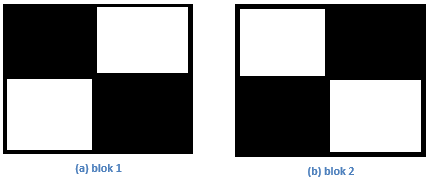

Każdemu pikselowi obrazu wejściowego odpowiada 4 pikselowy blok na obu udziałach (oznacza to, że oba udziały są 2 razy wyższe i 2 razy szersze niż obraz wejściowy). Jeżeli w obrazie wejściowym czytany jest piksel biały, w pierwszym udziale ustawiany jest blok (a), a w drugim (b), lub w pierwszym udziale ustawiany jest blok (b), a w drugim (a) – wybór jest losowy. Jeżeli czytany piksel jest czarny w pierwszym i drugim udziale ustawiany jest blok (a), lub w pierwszym i drugim udziale ustawiany jest blok (b) – wybór kombinacji również jest losowy. Istnieją inne rodzaje bloków do tworzenia udziałów, jak np.:

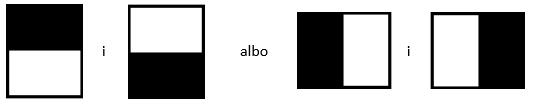

Ale powodują one odpowiednio zniekształcenia w pionie lub poziomie przy odtwarzaniu sekretu. Poniżej przykład sekretu, udziałów i odtworzenia sekretu z udziałów z użyciem bloków (a) i (b):

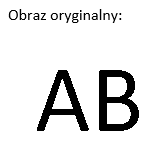

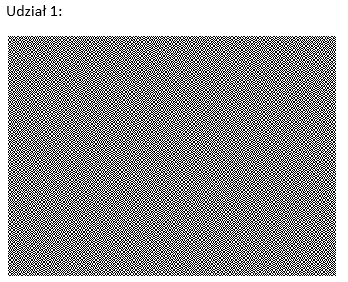

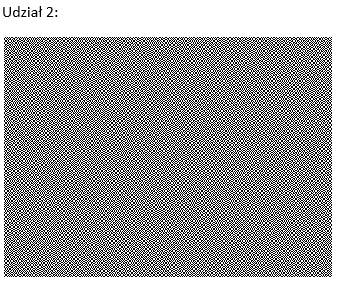

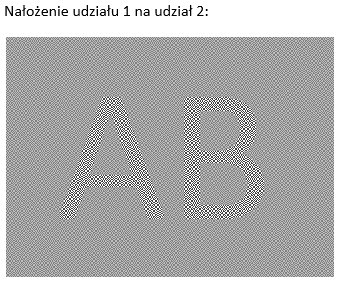

Ta technika jest o tyle ciekawa, że działa nie tylko na komputerze. Gdyby tak wziąć i oba udziały wydrukować na kartkach A4, a następnie nałożyć kartki na siebie i popatrzyć pod światło, sekretny tekst byłby wyraźnie widoczny. 

Ta metoda dotyczy bitmap i zawsze polega na utworzeniu dwóch udziałów. Istnieją metody pozwalajace na operowanie na obrazach w kolorze i pozwalajace na utworzenie większej liczby udziałów - ale one są już dość skomplikowane.

**Zadanie**

Napisz skrypt tworzący udziały z bitmapy, oraz skrypt nakładający dwa udziały i zapisujący wynik w formie obrazu. Gdy to zrobisz, utwórz prosty obraz czarno-biały, utwórz z niego udziały, nałóż udziały i zapisz wynik.

Poza tym, otrzmujesz 10 udziałów w folderze *Obrazy_dzielenie_sekretu*. Dwa z nich kodują tajne hasło, reszta to przypadkowy szum. Zapisz wynik nałożenia dwóch udziałów kodujących hasło.

In [4]:
def split_image(img):
    n, m = img.shape
    out_1, out_2 = np.empty((n * 2, m * 2)), np.empty((n * 2, m * 2))
    
    block_a = np.array([255, 0], [0, 255])
    block_b = np.array([0, 255], [255, 0])
    
    for i in range(n):
        for j in range(m):
            if np.random.rand() > 0.5:
                block_a, block_b = block_b, block_a
            
            if img[i, j] == 255:
                out_1[2 * i:2 * i + 1, 2 * j:2 * j + 1] = block_a
                out_2[2 * i:2 * i + 1, 2 * j:2 * j + 1] = block_b
            elif img[i, j] == 0:
                out_1[2 * i:2 * i + 1, 2 * j:2 * j + 1] = block_a
                out_2[2 * i:2 * i + 1, 2 * j:2 * j + 1] = block_a
                
    return out_1, out_2

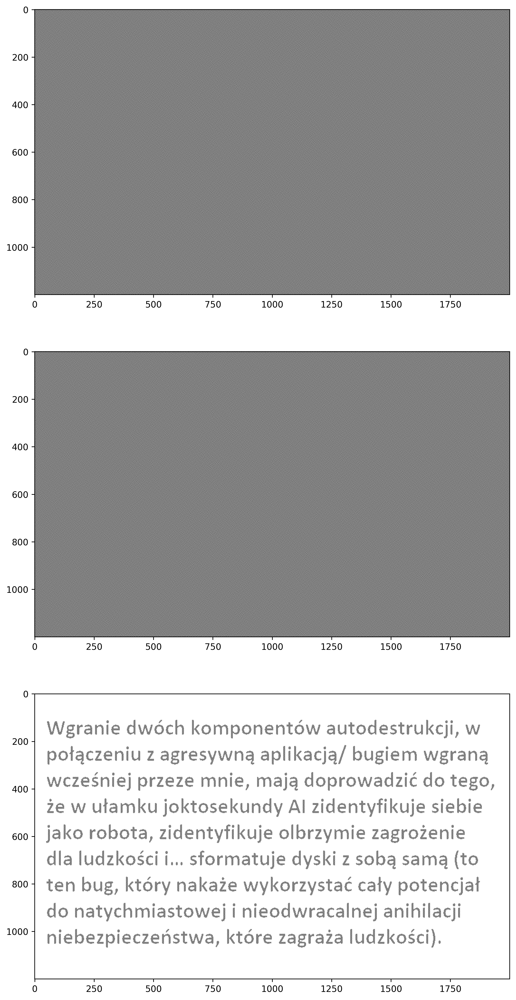

In [5]:
def join_images(img_1, img_2):
    return img_1 | img_2


images = [load_image(f'Obrazy_dzielenie_sekretu/{i}.png') for i in range(1, 11)]

fig, axs = plt.subplots(3, 1, figsize=(10, 20), dpi=350)
axs[0].imshow(images[9], cmap='gray')
axs[1].imshow(images[2], cmap='gray')
axs[2].imshow(join_images(images[9], images[2]), cmap='gray')
plt.show()

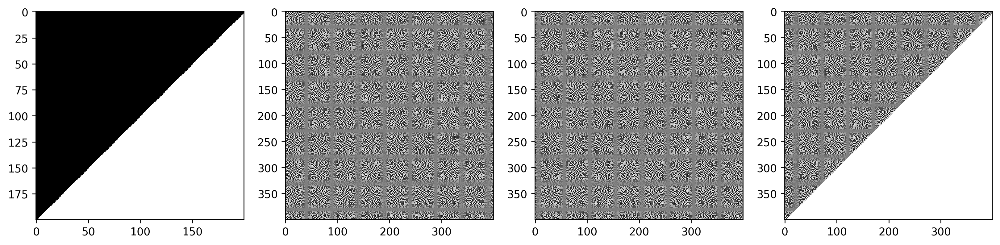

In [6]:
def split_image(img):
    n, m = img.shape
    out_1, out_2 = np.empty((n * 2, m * 2), dtype=np.int32), np.empty((n * 2, m * 2), dtype=np.int32)
    
    block_a = np.array([[1, 0], [0, 1]])
    block_b = np.array([[0, 1], [1, 0]])
    
    for i in range(n):
        for j in range(m):
            if np.random.rand() > 0.5:
                block_a, block_b = block_b, block_a
            
            if img[i, j] == 255:
                out_1[2 * i:2 * i + 2, 2 * j:2 * j + 2] = block_a
                out_2[2 * i:2 * i + 2, 2 * j:2 * j + 2] = block_b
            elif img[i, j] == 0:
                out_1[2 * i:2 * i + 2, 2 * j:2 * j + 2] = block_a
                out_2[2 * i:2 * i + 2, 2 * j:2 * j + 2] = block_a
                
    return out_1, out_2


img = np.zeros((200, 200))

for i in range(200):
    for j in range(200):
        if i + j > 200:
            img[i, j] = 255

img_1, img_2 = split_image(img)
            
fig, axs = plt.subplots(1, 4, figsize=(16, 4), dpi=250)
axs[0].imshow(img, cmap='gray')
axs[1].imshow(img_1, cmap='gray')
axs[2].imshow(img_2, cmap='gray')
axs[3].imshow(join_images(img_1, img_2), cmap='gray')
plt.show()

## Steganografia

Temat zapewne już większości znany, choćby przez projekty. Technika działająca w myśl zasady: *nie będziesz probował dostać się do treści wiadomości, jeśli nie wiesz, że wiadomość w ogóle istnieje*. Znowu wdzięcznym przedmiotem są tu obrazy, ale także np. pliki dźwiękowe. My skupimy się na obrazach, bo są o wiele łatwiejsze w obróbce, a skutek osiągniemy taki sam. Do zapamiętania jest natomiast jedna rzecz: do podstawowych metod steganografii nadają się pliki nie podlegające kompresji. A więc dla techniki opisanej poniżej dobre formaty to np.PNG i WAV np. złe formaty to np.: JPG oraz MP3.

Podstawową metodą steganograficzną jest tzw. LSB, czyli z ang. *Least Significant Bit*. W zamyśle chodzi o to, aby sekretną wiadomość zdekodować na ciąg binarny i ukrywać bit po bicie na najmniej znaczących bitach obrazu. I tu znowu jest sporo szkół i wariacji: można ukrywać po dwa bity - ale to może już spowodować widoczne zmiany w obrazie. Jeżeli obraz jest w kolorze, można ukrywać na jednym kanale, można na wszystkich. Wykorzystanie wiekszej liczby bitów pozwala na ukrycie większych wiadomości, ale naraża na ryzyko wykrycia, itp. itd. 

Steganografia nie jest w żaden sposób oficjalnie ustandaryzowana. No bo *czemu ktoś miałby chcieć coś ukrywać*, prawda? ;)

**Zadanie**

Wybierz sobie jakikolwiek obraz png w kolorze. Efektem jego wczytania powinno być uzyskanie trzech macierzy bajtów: odpowiednio kodujące R, G oraz B. Rozmiar każdej macierzy będzie oczywiście taki sam i będzie zależał od rozmiaru obrazu. Następnie zakoduj w obrazie wiadomość, ale z uwzględnieniem następujących założeń:
1. korzystamy z metody LSB,
2. koduj po jednym bicie na co dziesiątym bajcie, poczynając od pierwszego bajtu tablicy $R$,
3. rotuj kanałami w kolejności R, G, B,
4. w wiadomości korzystaj tylko ze znaków ASCII, a co za tym idzie przyjmij, że 1 znak to 1 bajt. Wiadomość ma się zaczynać od bajtu $0x02$ (z ASCII STX - czyli *Start of Text*), a kończyć bajtem $0x03$ (z ASCII ETX - czyli *End of Text*). Wartości te mogą być dodawane już na etpaie kodowania wiadomości do obrazu,
5. kontroluj, czy wiadomość, którą ktoś próbuje zakodować nie jest za długa dla danego obrazu - jeżeli jest, zwróć błąd.

To znaczy: pierwszy bit wiadomości będzie kodowany w $R[0]$, drugi w $G[10]$, trzeci w $B[20]$, czwarty w $R[30]$ itd. Zapisz obraz z zakodowaną wiadomością w formie umożliwiającej jego oglądnięcie. Wczytaj obraz z zakodowaną wiadomością, zdekoduj ją oraz przedstaw jej treść na ekranie.

Dolorem consectetur quaerat est dolor amet numquam. Quisquam quisquam labore voluptatem voluptatem quaerat sed dolore. Sed dolore quaerat tempora etincidunt. Voluptatem aliquam modi voluptatem velit n ...
Dolorem consectetur quaerat est dolor amet numquam. Quisquam quisquam labore voluptatem voluptatem quaerat sed dolore. Sed dolore quaerat tempora etincidunt. Voluptatem aliquam modi voluptatem velit n ...


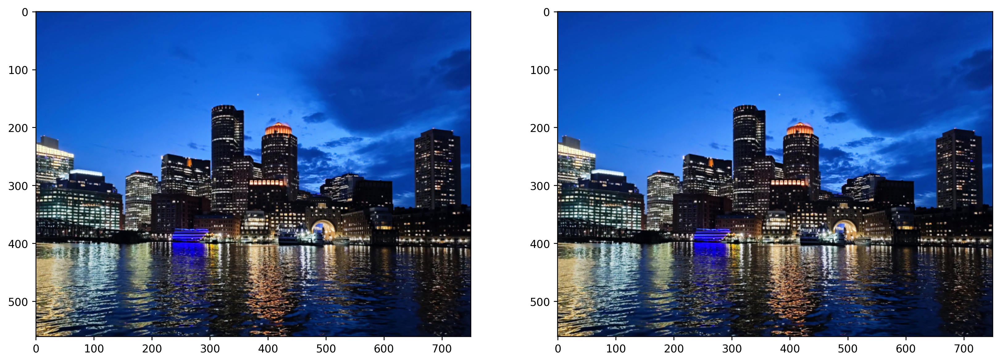

In [7]:
def add_msg(img, msg):
    shape = img.shape
    img = np.copy(img).reshape(-1, 3)
    
    codes = [0x02] + list(map(ord, msg)) + [0x03]
    channel, pos = 0, 0

    assert len(img) // 80 > len(codes), 'Too long message'
    
    for c in codes:
        for i in range(8):
            img[pos, channel] = (img[pos, channel] & 0b11111110) | (c % 2)
            pos += 10
            channel = (channel + 1) % 3
            c //= 2
        
    return img.reshape(shape)


def read_msg(img):
    img = np.copy(img).reshape(-1, 3)
    
    msg = []
    channel, pos = 0, 0
    
    while pos + 80 < len(img):
        bits = []
        
        for i in range(8):
            bits.append(img[pos, channel] % 2)
            pos += 10
            channel = (channel + 1) % 3
        
        char = 0
        
        for b in bits[::-1]:
            char = (char << 1) | b
        
        msg.append(char)
        
    start, end = 0, 0
    
    while msg[start] != 0x02:
        start += 1
        
    start, end = start + 1, start + 1
    
    while msg[end] != 0x03:
        end += 1
        
    msg = list(map(chr, msg[start:end]))
    return ''.join(msg)
    

import lorem

msg = lorem.text()
print(msg[:200], '...')

img = load_image('real_img.png')
img_mod = add_msg(img, msg)

print(read_msg(img_mod)[:200], '...')
 
fig, axs = plt.subplots(1, 2, figsize=(16, 8), dpi=250)
axs[0].imshow(img)
axs[1].imshow(img)
plt.show()